In [2]:
import os
import json
from skimage import io
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image

from scipy.linalg import svd

In [10]:
os.chdir("E:\M596 Project")

base_directory = os.getcwd()

data_directory = os.path.join(base_directory, 'New_dataset\GreenChannel_DR_dataset')
dat_0_directory = os.path.join(data_directory, '0')
dat_1_directory = os.path.join(data_directory, '1')
dat_2_directory = os.path.join(data_directory, '2')
dat_3_directory = os.path.join(data_directory, '3')
dat_4_directory = os.path.join(data_directory, '4')

In [60]:
def class_images_generator(directory, class_name=None, batch_size=100, target_size=(512, 512)):
    """
    Get images of a specific class from the specified directory.

    Parameters:
    - directory: Path to the directory containing the images.
    - class_name: Name of the class for which to retrieve images.
    - target_size: Target size, formatted as (height, width).
    - batch_size: Number of images to load per batch.

    Returns:
    Returns an ImageDataGenerator that can be used to iterate over images of the specified class.
    """
    # Use the 'classes' parameter if 'class_name' is specified; otherwise, ignore the 'classes' parameter
    classes = [class_name] if class_name else None

    # Use flow_from_directory to retrieve images of the specified class
    image_datagen = ImageDataGenerator(rescale=1./255)
    class_images_generator = image_datagen.flow_from_directory(
        directory,
        target_size=target_size,
        batch_size=batch_size,
        classes=classes,
        class_mode='categorical',  # Make sure to use the 'categorical' class mode
        color_mode='grayscale',    # Set to 'grayscale' to read grayscale images
        shuffle=True
    )

    return class_images_generator


In [61]:
dat_0_generator = class_images_generator(data_directory, class_name='0')
dat_1_generator = class_images_generator(data_directory, class_name='1')
dat_2_generator = class_images_generator(data_directory, class_name='2')
dat_3_generator = class_images_generator(data_directory, class_name='3')
dat_4_generator = class_images_generator(data_directory, class_name='4')
dat_all_generator = class_images_generator(data_directory)

Found 12924 images belonging to 1 classes.
Found 1267 images belonging to 1 classes.
Found 2860 images belonging to 1 classes.
Found 500 images belonging to 1 classes.
Found 353 images belonging to 1 classes.
Found 17904 images belonging to 5 classes.


In [62]:
def flatten_images_mean(image_generator):
    """
    Flatten batches of images and compute the mean of the flattened image matrices.

    Parameters:
    - image_generator: ImageDataGenerator containing images.

    Returns:
    - mean_flattened_image: Mean of the flattened image matrix.
    """
    sum_image_total = None
    num_images_total = 0

    for batch_images, _ in image_generator:
        num_images = len(batch_images)
        num_images_total += num_images
        num_row, num_col, _ = np.shape(batch_images[0])

        # Create a local image matrix
        image_mat = np.zeros((num_row * num_col, num_images), dtype=np.float64)

        # Flatten each image and add it to the local image matrix
        for cnt, image in enumerate(batch_images):
            image_mat[:, cnt] = image.flatten()

        # Calculate the sum of the image matrices for each batch
        sum_image_mat = np.sum(image_mat, axis=1)

        # Accumulate the sum for each batch
        if sum_image_total is None:
            sum_image_total = sum_image_mat
        else:
            sum_image_total += sum_image_mat

    # Compute the mean
    mean_flattened_image = sum_image_total / num_images_total

    return mean_flattened_image

In [63]:
batch_images, _ = next(dat_4_generator)
np.shape(batch_images[0])
#len(batch_images)

(512, 512, 1)

In [64]:
sum_image_total = None
num_images_total = 0

num_images = len(batch_images)
num_images_total += num_images
num_row, num_col, _ = np.shape(batch_images[0])
image_mat = np.zeros((num_row * num_col, num_images), dtype=np.float64)

for cnt, image in enumerate(batch_images):
            image_mat[:, cnt] = image.flatten()
mean = np.mean(image_mat, axis = 1)

out_mean = image_mat - np.tile(mean.reshape(-1,1), (1, 100))

#np.tile(mean.reshape(-1,1), (1, 100)).shape
out_mean.shape

(262144, 100)

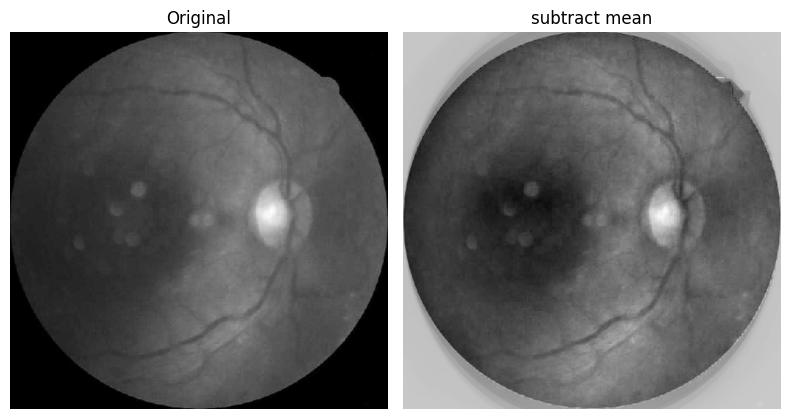

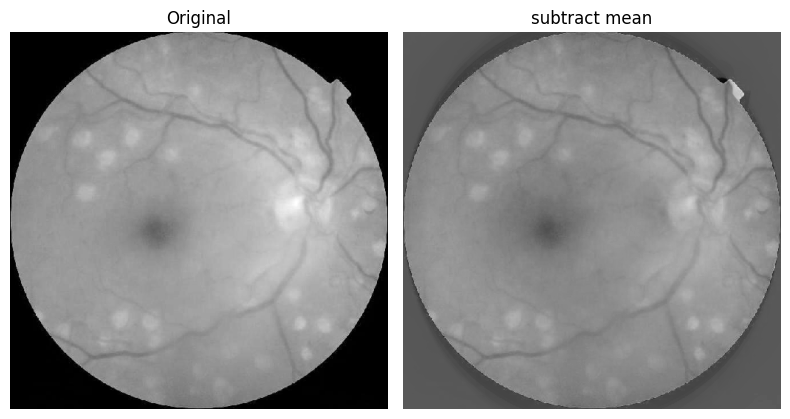

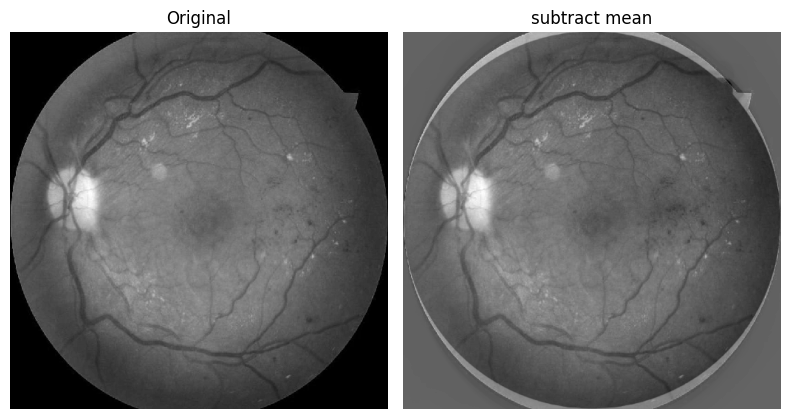

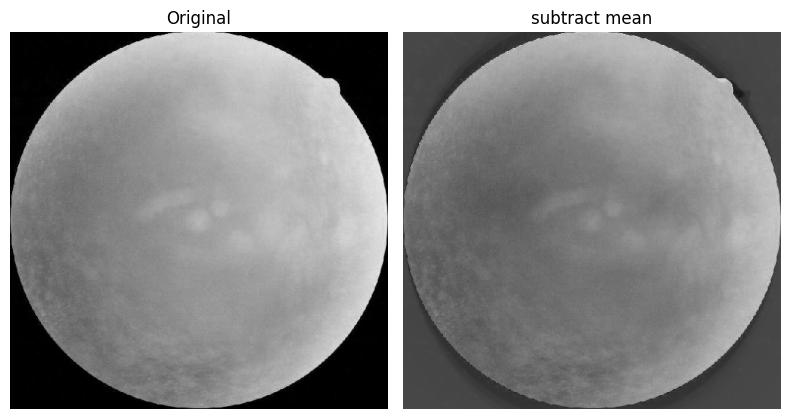

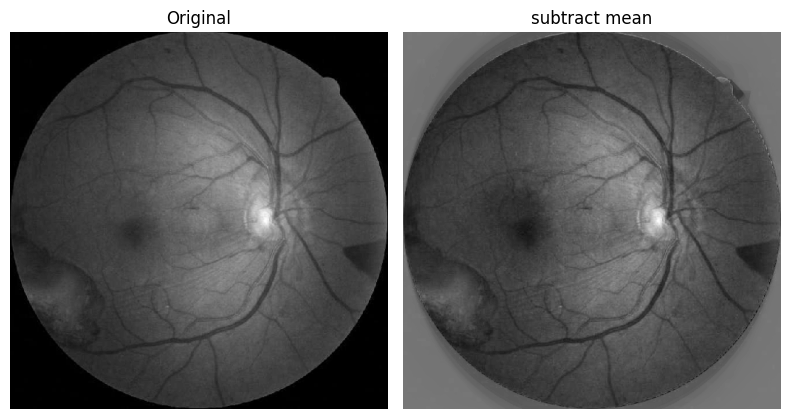

...

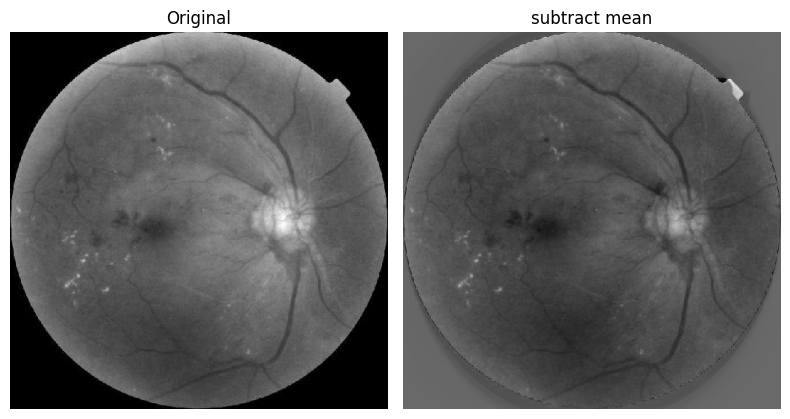

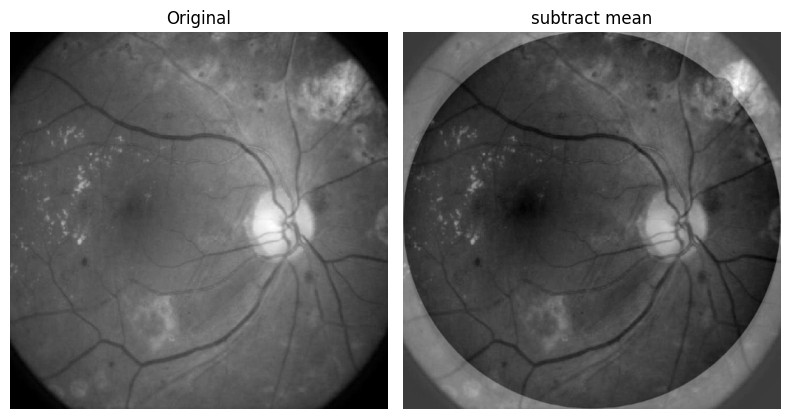

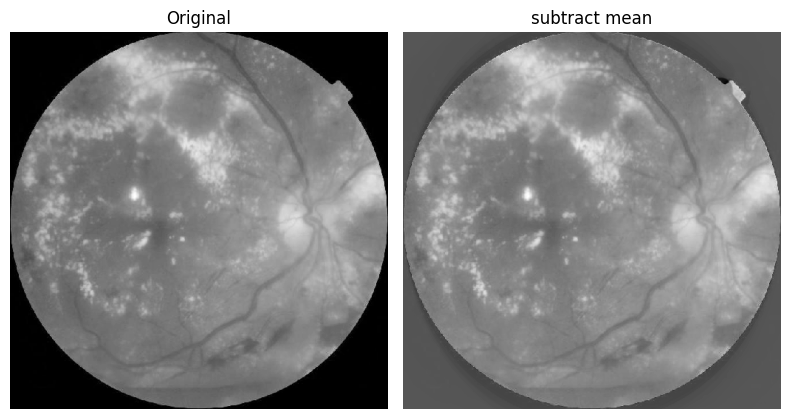

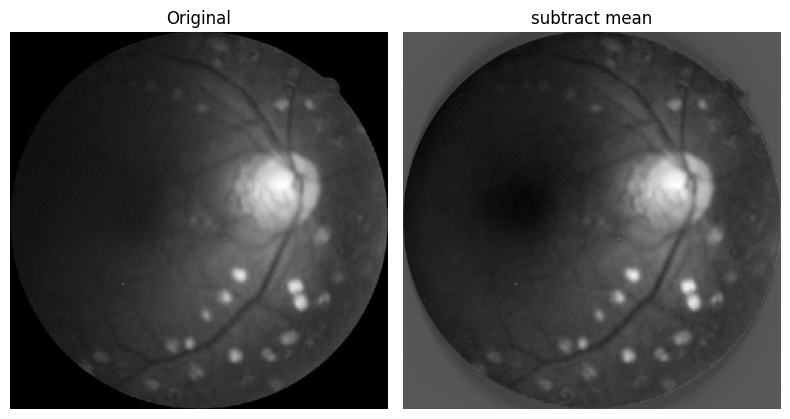

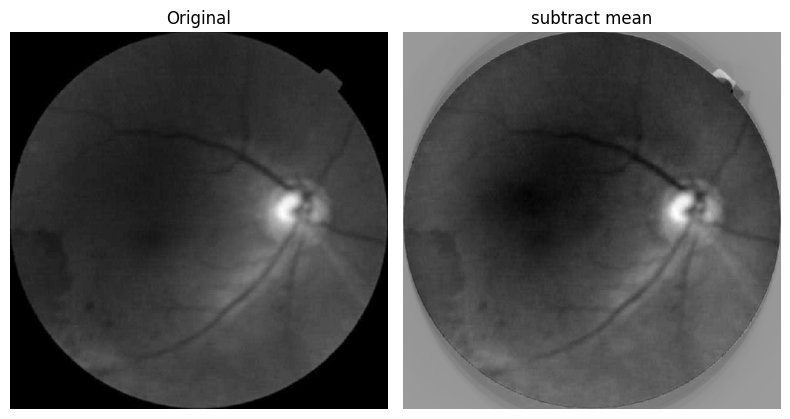

In [65]:
for i in range(100):
    plt.subplot(1,2,1)
    plt.imshow(image_mat[:,i].reshape(num_row,num_col), cmap='gray')
    plt.title("Original")
    plt.axis('off')
    
    
    plt.subplot(1, 2, 2)
    plt.imshow(out_mean[:,i].reshape(num_row,num_col), cmap='gray')
    plt.title("subtract mean")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

(-0.5, 511.5, 511.5, -0.5)

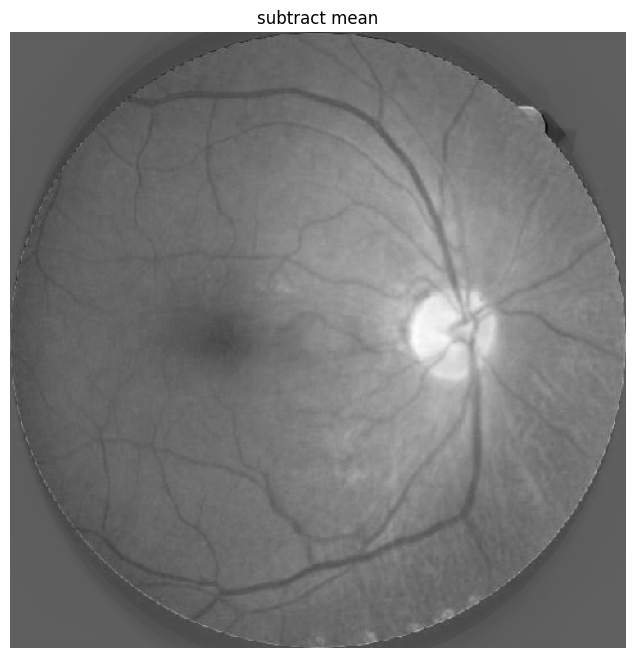

In [66]:
plt.imshow(out_mean[:,26].reshape(num_row,num_col), cmap='gray')
plt.title("subtract mean")
plt.axis('off')

In [87]:
temp1 = out_mean[:,26].reshape(num_row, num_col)

In [88]:
temp2 = image_mat[:,26].reshape(num_row,num_col)

<function matplotlib.pyplot.show(close=None, block=None)>

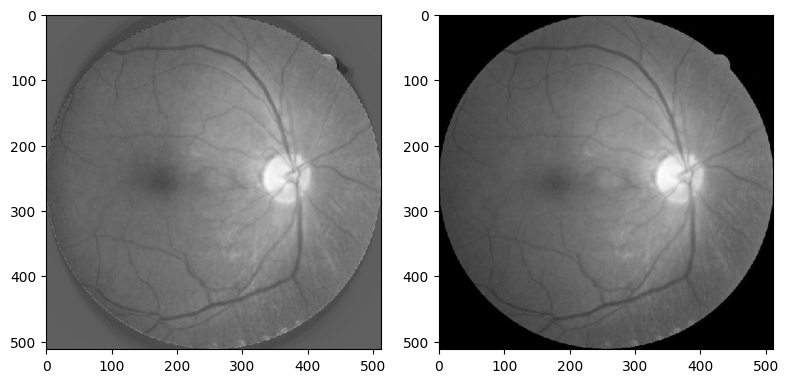

In [89]:
plt.subplot(1,2,1)
plt.imshow(temp1, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(temp2, cmap='gray')
plt.tight_layout()
plt.show

(512, 512)
(512, 512)
(512, 512)
(512, 512)


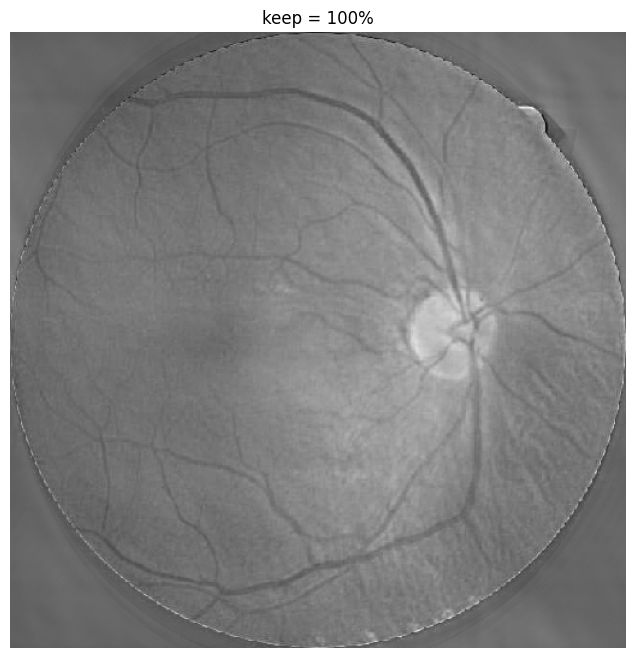

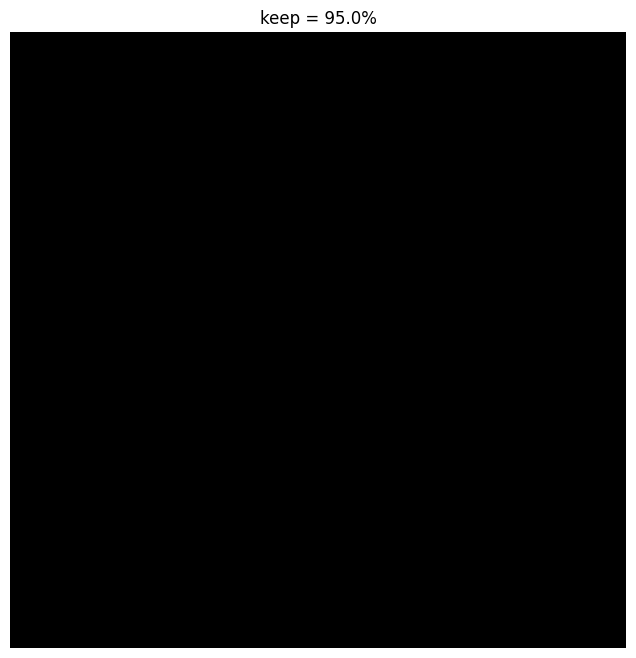

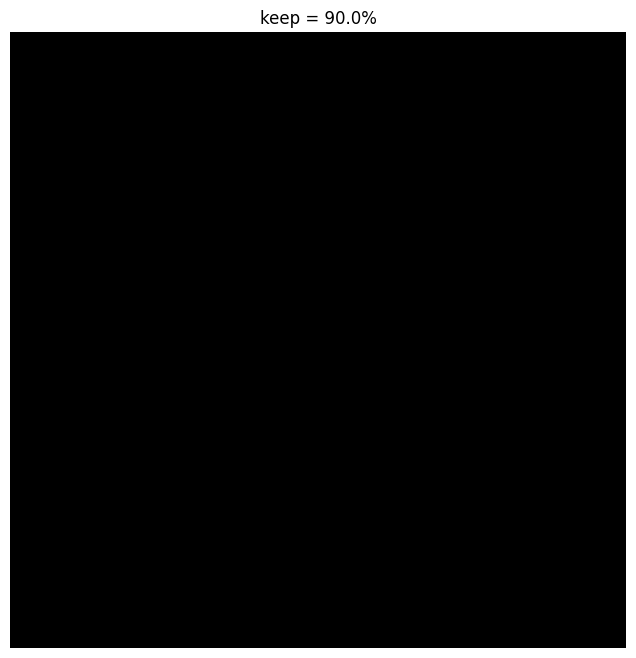

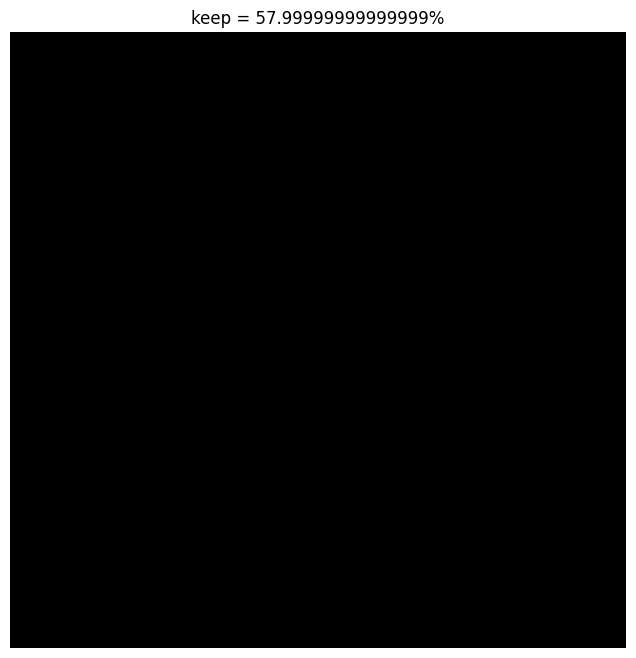

In [90]:
Bt1 = np.fft.fft2(temp1)
Btsort1 = np.sort(np.abs(Bt1.reshape(-1)))

for keep in (1,.95,0.90,0.58):
    thresh1 = Btsort1[int(np.floor((1-keep)*len(Btsort1)))]
    ind1 = np.abs(temp1)> thresh1
    Atlow1 = Bt1 *ind1
    Alow1 = np.fft.ifft2(Atlow1).real
    print(Atlow1.shape)
    plt.figure()
    plt.imshow(Alow1, cmap = 'gray')
    plt.axis('off')
    plt.title(f'keep = ' + str(keep*100)+ '%')

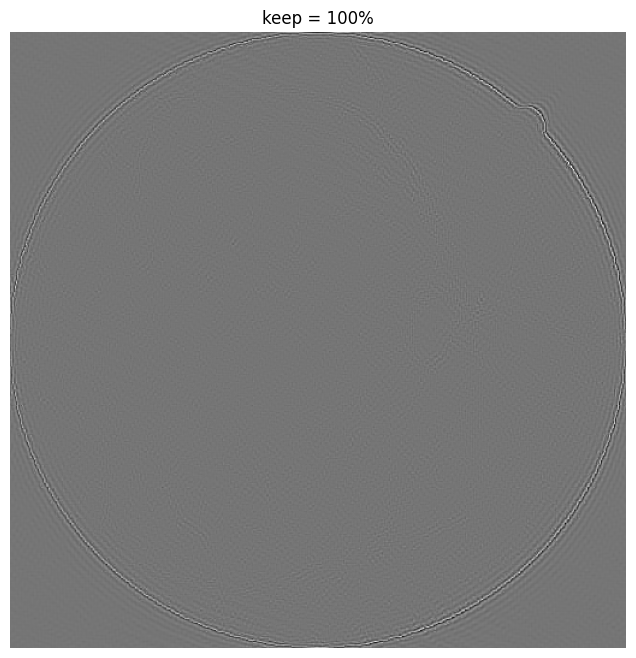

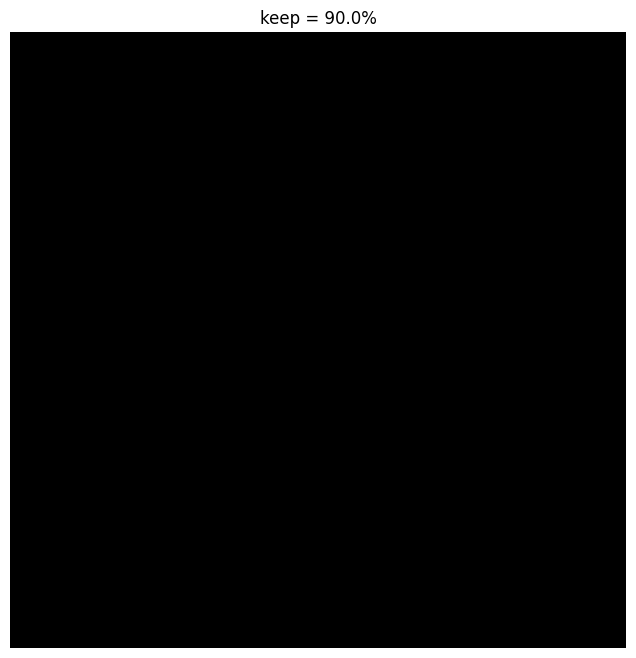

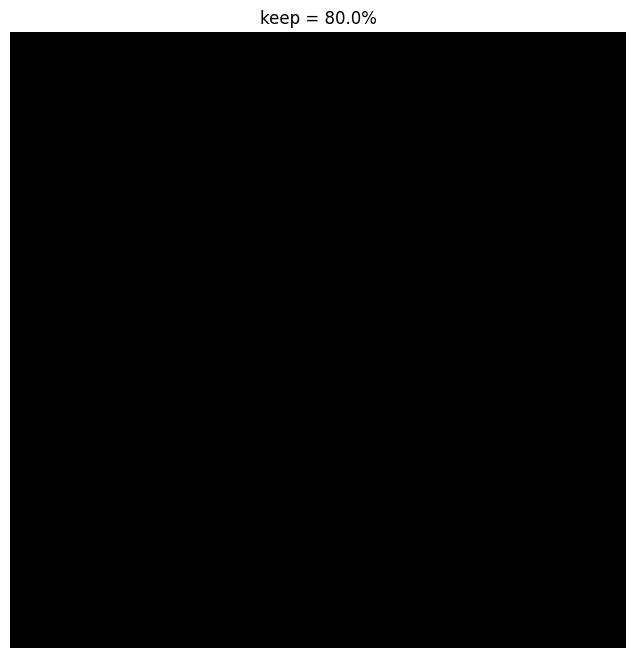

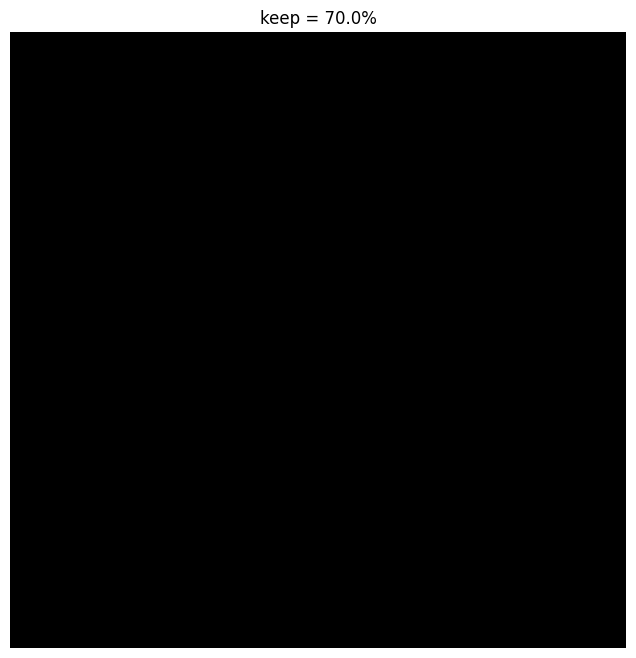

In [91]:
Bt2 = np.fft.fft2(temp2)
Btsort2 = np.sort(np.abs(Bt2.reshape(-1)))

for keep in (1,0.9,0.8,0.7):
    thresh2 = Btsort2[int(np.floor((1-keep)*len(Btsort2)))]
    ind2 = np.abs(temp2)> thresh2
    Atlow2 = Bt2 *ind2
    Alow2 = np.fft.ifft2(Atlow2).real
    plt.figure()
    plt.imshow(Alow2, cmap = 'gray')
    plt.axis('off')
    plt.title(f'keep = ' + str(keep*100)+ '%')

In [54]:
import pywt

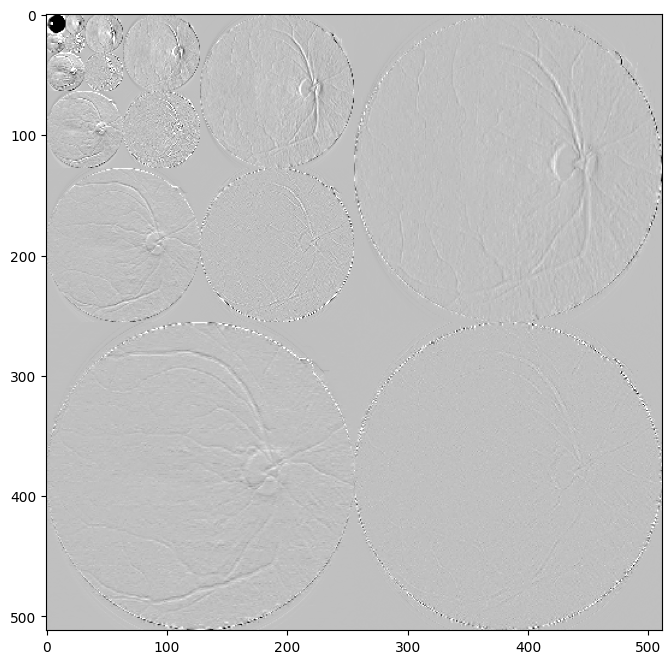

In [92]:
n = 5
w = 'db1'

coeffs = pywt.wavedec2(temp1, wavelet = w, level = n)

for detail_level in range(n):
    coeffs[detail_level +1] = [d/np.abs(d).max() for d in coeffs[detail_level + 1]]

arr, coeff_slices = pywt.coeffs_to_array(coeffs)

plt.imshow(arr,cmap='gray_r',vmin=-0.25,vmax=0.75)
plt.rcParams['figure.figsize'] = [16,16]
plt.show()


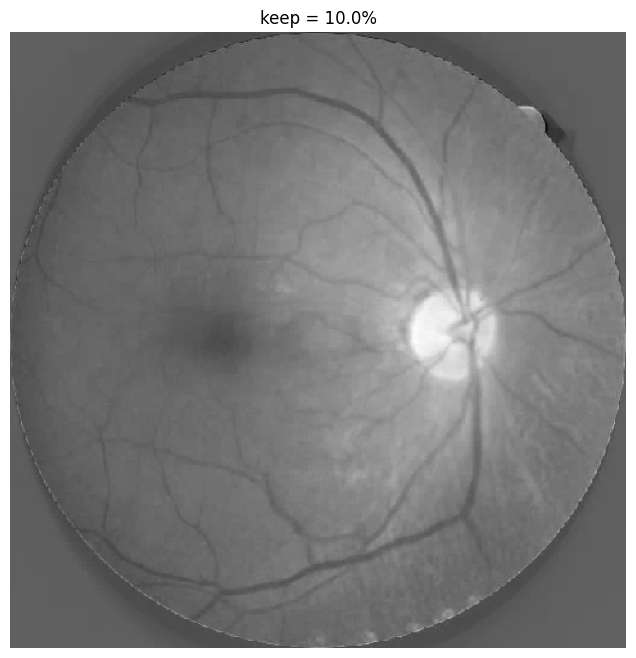

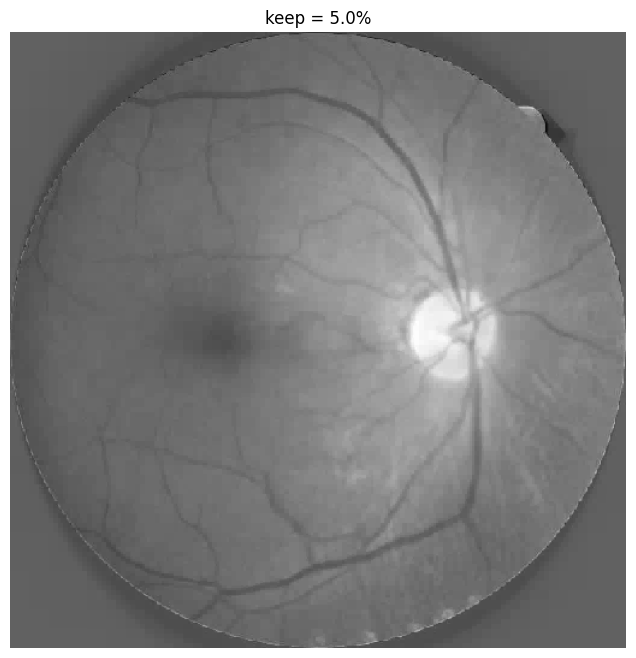

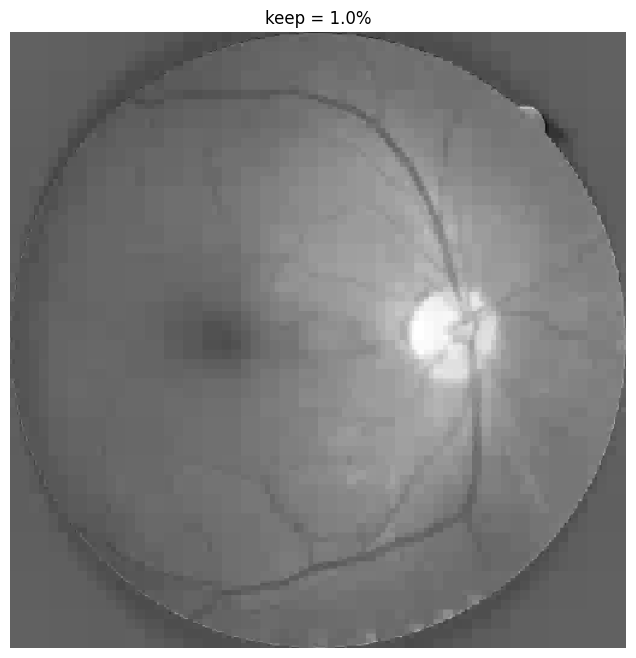

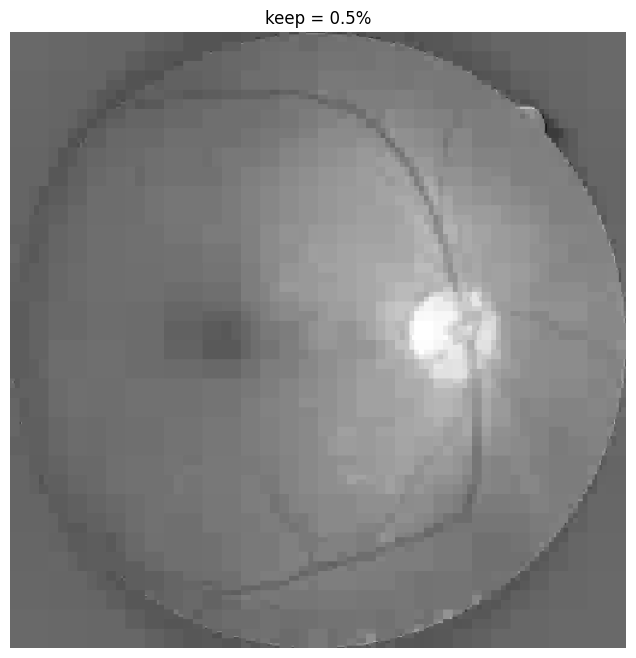

In [95]:
n = 5
w = 'db1'

coeffs = pywt.wavedec2(temp1, wavelet = w, level = n)

coeff_arr, coef_slices = pywt.coeffs_to_array(coeffs)

Csort = np.sort(np.abs(coeff_arr.reshape(-1)))

for keep in (0.1,0.05,0.01,0.005):
    thresh = Csort[int(np.floor((1-keep)*len(Csort)))]
    ind = np.abs(coeff_arr)> thresh
    Cfilt = coeff_arr *ind
    coeffs_filt = pywt.array_to_coeffs(Cfilt, coeff_slices, output_format = 'wavedec2')
    Arecon = pywt.waverec2(coeffs_filt, wavelet = w)
    plt.figure()
    plt.imshow(Arecon, cmap = 'gray')
    plt.axis('off')
    plt.rcParams['figure.figsize'] = [8,8]
    plt.title(f'keep = ' + str(keep*100)+ '%')

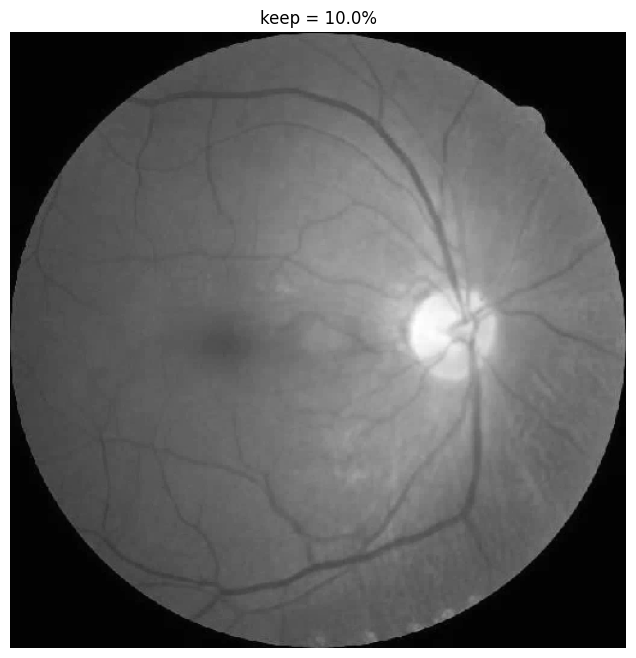

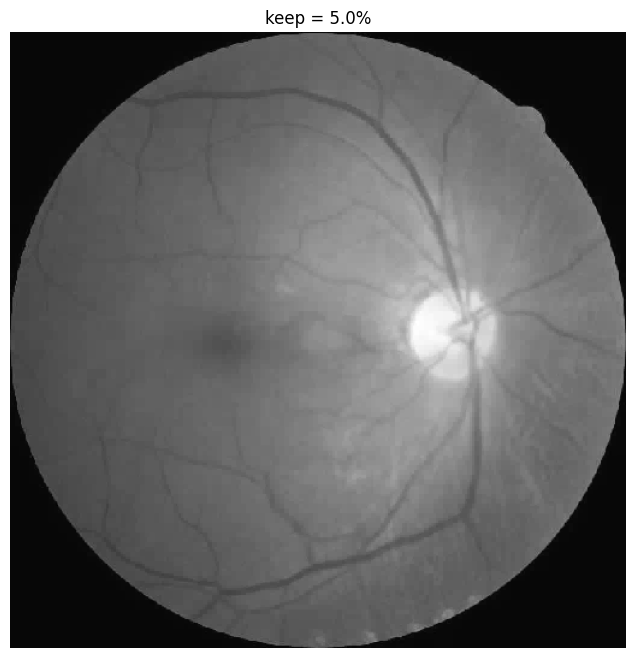

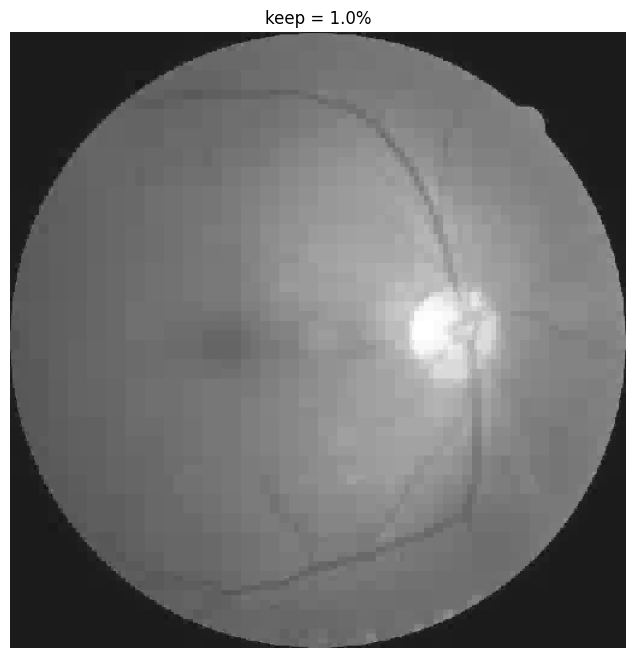

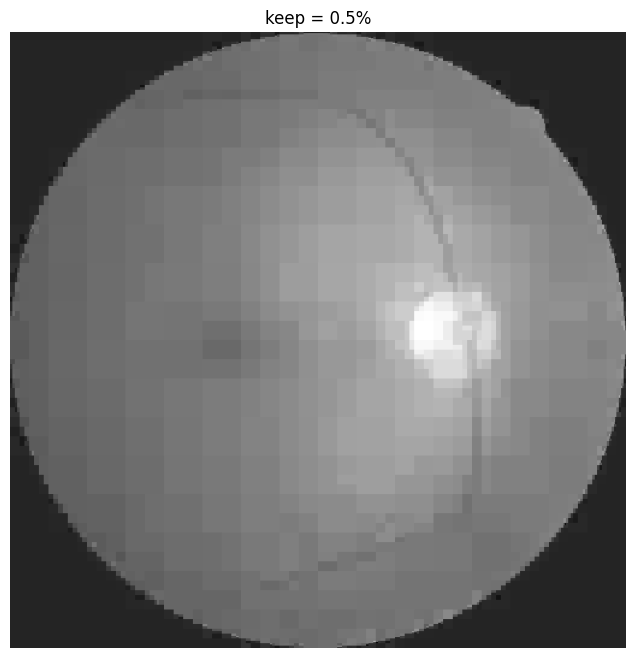

In [94]:
n = 5
w = 'db1'

coeffs = pywt.wavedec2(temp2, wavelet = w, level = n)

coeff_arr, coef_slices = pywt.coeffs_to_array(coeffs)

Csort = np.sort(np.abs(coeff_arr.reshape(-1)))

for keep in (0.1,0.05,0.01,0.005):
    thresh = Csort[int(np.floor((1-keep)*len(Csort)))]
    ind = np.abs(coeff_arr)> thresh
    Cfilt = coeff_arr *ind
    coeffs_filt = pywt.array_to_coeffs(Cfilt, coeff_slices, output_format = 'wavedec2')
    Arecon = pywt.waverec2(coeffs_filt, wavelet = w)
    plt.figure()
    plt.imshow(1-Arecon, cmap = 'gray_r')
    plt.axis('off')
    plt.rcParams['figure.figsize'] = [8,8]
    plt.title(f'keep = ' + str(keep*100)+ '%')

In [99]:
features, samples = image_mat.shape

In [100]:
print(features*.1,features*.05)

26214.4 13107.2
